# Neural Style Transfer for Images

Neural Style Transfer (NST) is one of the most fun techniques in deep learning. It merges two images namely, a `content image (C)` and a `style image (S)`, to create a `generated image (G)`. The generated image G combines the **content** of the image C with the **style** of image S. 

For example, let’s take an image of this turtle and Katsushika Hokusai's `The Great Wave off Kanagawa`:

<img src="https://res.cloudinary.com/dpyleb8ih/image/upload/v1560278258/example.jpg">

Style transfer is an interesting technique that showcases the capabilities and internal representations of neural networks.  

## Table of contents

- Naive Implementation
- Tensorflow official guide for Neural Style Transfer
    - Fast Style Transfer using TF-Hub
    - Building a model
    
The difference between naive implementation and tensorflow official guide for building neural style transfer model is the way of implementing the loss and training step. Also in official guide, it implements **total variation loss** to decrease the high frequency of style in the generated image. Overall the tensorflow official guide has much better way (tensorflowish way) of implementation.

Note: This official guide part demonstrates the `original style-transfer algorithm`. It optimizes the image content to a particular style. **Modern approaches train a model to generate the stylized image directly (similar to [cyclegan](cyclegan.ipynb)). This approach is much faster (up to 1000x)**.

## Naive Implementation

In [1]:
from IPython import display

import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications.vgg19 import VGG19

from PIL import Image

In [2]:
# Downloading images

!wget --quiet https://upload.wikimedia.org/wikipedia/commons/d/d7/Green_Sea_Turtle_grazing_seagrass.jpg
!wget --quiet https://upload.wikimedia.org/wikipedia/commons/0/0a/The_Great_Wave_off_Kanagawa.jpg

In [3]:
# Defining content and style imgs
CONTENT_IMG = 'Green_Sea_Turtle_grazing_seagrass.jpg'
STYLE_IMG   = 'The_Great_Wave_off_Kanagawa.jpg'

# Img dimensions for our content and style imgs
IMG_HEIGHT = 300
IMG_WIDTH  = 400

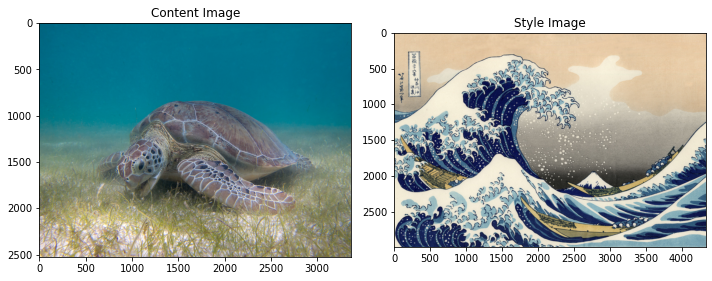

In [4]:
# Visualizing the input images

content_img = Image.open(CONTENT_IMG)
style_img   = Image.open(STYLE_IMG)

plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
plt.imshow(content_img)
plt.title('Content Image')

plt.subplot(1, 2, 2)
plt.imshow(style_img)
plt.title('Style Image')

plt.tight_layout()
plt.show()

In [5]:
# Getting the image ready
def load_and_process_img(filename, img_resize_dim=(IMG_HEIGHT, IMG_WIDTH), print_img_shape=False):
    img_tensor_str = tf.io.read_file(filename)
    img = tf.image.decode_jpeg(img_tensor_str, channels=3)
    img = tf.cast(img, dtype=tf.float32)
    
    # Resize the image
    img = tf.image.resize(img, size=img_resize_dim)
    
    # Add batch dimension
    img = tf.expand_dims(img, axis=0)
    
    if print_img_shape:
        print(f'Image shape: {img.shape}')
    
    return img


load_and_process_img(CONTENT_IMG, print_img_shape=True)
load_and_process_img(STYLE_IMG, print_img_shape=True)
pass

Image shape: (1, 300, 400, 3)
Image shape: (1, 300, 400, 3)


### Preprocess

We will be using `VGG19` model using Transfer learning as it was done in the paper. One thing to note that we need to process our images into image preprocessing step. VGG networks( and other ImageNet models) are trained on image with each channel normalized by `mean = [103.939, 116.779, 123.68]`and with channels BGR. Although it's not a complicated function to write, it's already written in keras so we don't need to do it ourselves.

In [6]:
def load_and_process_img_from_vgg19(filename, print_img_shape=False):
    img = load_and_process_img(filename)
    img = keras.applications.vgg19.preprocess_input(img)
    
    if print_img_shape:
        print(f'Image shape: {img.shape}')
    return img


load_and_process_img_from_vgg19(CONTENT_IMG, print_img_shape=True)
load_and_process_img_from_vgg19(STYLE_IMG, print_img_shape=True)
pass

Image shape: (1, 300, 400, 3)
Image shape: (1, 300, 400, 3)


In order to view the outputs of our optimization, we are required to perform the inverse preprocessing step. Also, we must clip to maintain our values from within the 0-255 range.   

In [7]:
# Visualizing color channel reversing 
def color_channels_reversing_example():
    # Creating matrix of height, width == 300, 400 and 3 channels
    matrix = np.zeros((300, 400, 3))
    
    # Assigning values to 1st, 2nd and 3rd channels respectively
    matrix[:, :, 0] = 0
    matrix[:, :, 1] = 1
    matrix[:, :, 2] = 2
    
    print(f'Before reversing: \n{matrix[0]}\n')
    matrix = matrix[:, :, ::-1]
    print(f'After reversing: \n{matrix[0]}')
    return matrix


color_channels_reversing_example()

print()

# Visualizing clipping
def visualizing_clipping_of_matrix():
    # Creating matrix of height, width == 300, 400 and 3 channels
    matrix = np.zeros((300, 400, 3))
    
    # Assigning values to 1st, 2nd and 3rd channels respectively
    matrix[:, :, 0] = 0
    matrix[:, :, 1] = 5
    matrix[:, :, 2] = 10
    print(f'Before clipping: \n{matrix[0]}\n')
    min_value = 3
    max_value = 7
    matrix = np.clip(matrix, min_value, max_value)
    print(f'After clipping: \n{matrix[0]}\n')
    
    
visualizing_clipping_of_matrix()

Before reversing: 
[[0. 1. 2.]
 [0. 1. 2.]
 [0. 1. 2.]
 ...
 [0. 1. 2.]
 [0. 1. 2.]
 [0. 1. 2.]]

After reversing: 
[[2. 1. 0.]
 [2. 1. 0.]
 [2. 1. 0.]
 ...
 [2. 1. 0.]
 [2. 1. 0.]
 [2. 1. 0.]]

Before clipping: 
[[ 0.  5. 10.]
 [ 0.  5. 10.]
 [ 0.  5. 10.]
 ...
 [ 0.  5. 10.]
 [ 0.  5. 10.]
 [ 0.  5. 10.]]

After clipping: 
[[3. 5. 7.]
 [3. 5. 7.]
 [3. 5. 7.]
 ...
 [3. 5. 7.]
 [3. 5. 7.]
 [3. 5. 7.]]



In [8]:
def deprocess_img(processed_img):
    # To not to manipulate the original img
    img = processed_img.copy()
    
    if len(img.shape) == 4:
        img = np.squeeze(img, 0)

    # Checking the img shape is 3 or not
    assert len(img.shape) == 3, 'Input to deprocess image must be an image of dimension [1, height, width, channel] or [height, width, channel]'
    # if len(img.shape) != 3:
    #     raise ValueError('Invalid input to deprocessing image')
        
    # Perform the inverse of the preprocessing step (color channels)
    img[:, :, 0] += 103.939
    img[:, :, 1] += 116.779
    img[:, :, 2] += 123.68
    
    # Convert back to RGB from BGR
    img = img[:, :, ::-1]

    img = np.clip(img, 0, 255).astype('uint8')
    return img

In [9]:
# VGG19 model summary to get see the intermediate layers
vgg19_model = VGG19(include_top=False, weights=None, input_shape=(IMG_HEIGHT, IMG_WIDTH, 3))
vgg19_model.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 300, 400, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 300, 400, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 300, 400, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 150, 200, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 150, 200, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 150, 200, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 75, 100, 128)      0     

### Define content and style representations

We will use the intermediate layers of the model to get the content and style representations of the image. 

**Why intermediate layers?**

At a high level, in order for a network to perform image classification, it must understand the image. This involves taking the raw image as input pixels and building an internal representation through transformations that turn the raw image pixels into a complex understanding of the features present within the image. Starting from the network's input layer, the first few layer activations represent low-level features like edges and textures. As you step through the network, the final few layers represent higher-level features. These intermediate layers are necessary to define the representation of content and style from the images. The model serves as a complex feature extractor; hence by accessing intermediate layers, we’re able to describe the content and style of input images. 

We would like the "generated" image G to have similar content as the input image C. Suppose we have chosen some layer's activations to represent the content of an image. We'll get the most visually pleasing results if we choose a layer in the middle of the network--neither too shallow nor too deep. (Feel free to experiment with using different layers, to see how the results vary.)

In [10]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv2'] 

# Style layers
style_layers = [
    'block1_conv1',
    'block2_conv1',
    'block3_conv1', 
    'block4_conv1', 
    'block5_conv1'
]

Creates our model with access to intermediate layers. Loads the VGG19 model and access the intermediate layers. These layers will then be used to create a new model that will take input imageand return the outputs from these intermediate layers from the VGG model.

In [11]:
def build_model(style_layers, content_layers):
    # loading pre-trained vgg19 model
    model = VGG19(include_top=False, weights='imagenet', input_shape=(IMG_HEIGHT, IMG_WIDTH, 3))
    model.trainable = False
    
    # Get output layers corresponding to style and content layers 
    content_outputs = [model.get_layer(layer_name).output for layer_name in content_layers]
    style_outputs   = [model.get_layer(layer_name).output for layer_name in style_layers]
    
    # Combining the output 
    model_outputs = style_outputs + content_outputs
    # model_outputs = content_outputs + style_outputs
    
    neural_style_transfer_model = Model(model.input, model_outputs)
    return neural_style_transfer_model

### Losses

We will build the NST algorithm in three steps:

- Build the content loss function $L_{content}(C,G)$
- Build the style loss function $L_{style}(S,G)$
- Put it together to get $L(G) = \alpha L_{content}(C,G) + \beta L_{style}(S,G)$. 

#### Content Loss

Our content loss function is actually quite simple. We will try to measure how much is the G(Generated image) and C(Content image) are similar to each other. Now, we will set the image C as the input to the pretrained VGG network, and run forward propagation. $a^{(C)}$ will be the hidden layer activations in the layer we had chosen. This will be a 3D Tensor with the shape of [H, W, C]. Then we'll repeat this process with the image G as well. Therefore $a^{(G)}$ will be the corresponding hidden layer activation. We then can define as the content loss function as:

$$L_{content}(C,G) = \sum _{ \text{all entries}} (a^{(C)} - a^{(G)})^2 $$

In [12]:
def content_loss(content, generated):
    return tf.reduce_mean(tf.square(content - generated))

#### Style Loss

The content of an image is represented by the values of the intermediate feature maps.

It turns out, the style of an image can be described by the means and correlations across the different feature maps. We will calculate a Gram matrix that includes this information by taking the outer product of the feature vector with itself at each location, and averaging that outer product over all locations. 

After generating the Style matrix (Gram matrix), we will minimize the distance between the Gram matrix of the image S and image G. For now, we can derive the loss using only a single hidden layer $a^{[l]}$, and the corresponding style loss for this layer is defined as: 

$$L_{style}^{[l]}(S,G) = \sum_{i,j}(Gram^{(S)}_{ij} - Gram^{(G)}_{ij})^2 $$

where $G^{(S)}$ and $G^{(G)}$ are respectively the Gram matrices of the style image and the generated image, computed using the hidden layer activations for a particular hidden layer in the network.

It turns out that you get more visually pleasing results if you use the style loss function from multiple different layers. So, the overall style cost function, we can define as:

$$L_{style}(S,G) = \sum_{l} \lambda^{[l]} L^{[l]}_{style}(S,G)$$

where the values for $\lambda^{[l]}$ are given in `STYLE_LAYERS`. 

In [13]:
# This example will help in understanding the calculations and
# dimension changes while calculating the gram matrix

# Creating matrix of height, width == 300, 400 and 3 channels
a_matrix = np.zeros((300, 400, 3))
print(a_matrix.shape)
tf.reshape(a_matrix, [-1, 3]).shape

(300, 400, 3)


TensorShape([120000, 3])

In [14]:
# Calculate the gram matrix
def gram_matrix(tensor):
    # if channels last
    channels = int(tensor.shape[-1])
    a = tf.reshape(tensor, [-1, channels])
    gram = tf.matmul(a, a, transpose_a=True)
    return gram / tf.cast(tf.shape(a)[0], tf.float32)


# Calcualte style loss for a layer
def layer_style_loss(style, generated):
    gram_style = gram_matrix(style)
    gram_generated = gram_matrix(generated)
    return tf.reduce_mean(tf.square(gram_style - gram_generated))


# Calculate style loss for all the layers
def style_loss(style, generated):
    loss = 0
    
    # lambda values (5 values of 0.2 as we have 5 layers in style_layers)
    coeffs = [0.2, 0.2, 0.2, 0.2, 0.2]
    
    for s, g, coeff in zip(style, generated, coeffs):
        loss += coeff * layer_style_loss(s, g)

    return loss

### Define Total Loss

This is where we will combine style and content losses together. 

$$L(G) = \alpha L_{content}(C,G) + \beta L_{style}(S,G)$$ 

In [15]:
def compute_loss(model, image, style_features, content_features, alpha=0.1, beta=0.002):
    # Feed our init image through our model.
    model_outputs = model(image)
    
    # Taking the 1st element as we only have one content layer
    content_generated = [content_layer[0] for content_layer in model_outputs[len(style_layers):]][0]
    
    # Taking all the style_layers (4 in this case), also taking multiple style layers will 
    # good generated style
    style_generated   = [style_layer for style_layer in model_outputs[:len(style_layers)]]
    
    content_loss_value = alpha * content_loss(content_features, content_generated)
    style_loss_value   = beta * style_loss(style_features, style_generated)
    
    # Get total loss
    loss = style_loss_value + content_loss_value
    return loss

#### Gradient Tape and Eager Execution

A lot of things are changing with TensorFlow 2.0 like default execution mode changing from Graph which is where we build our graph and then execute it to eager which is where the operations are executed immediately like a normal Python variable. The problem we are dealing with here is not the build a model and use it to make predictions but rather use an existing model to extract feature maps and then use them to generate a new image. What we will be doing is that using the error we calculated just now to apply it on our G image which is a noisy image or could be the content image itself. Remember we use optimizer to minimize the loss and that would train our network?. The idea behind that is that optimizer calls two function behind the minizie function:

- Compute gradients
- Apply gradients

**Compute Gradients**: This is where tensorflow helps us the most by calculating the derivaties between the output and input according to our loss function.

**Apply Gradients**: After the gradients were calculated, optimize calls this function to apply gradients to trainable variables in our graph. That's how the backpropagation works :) 

Now, back to our problem. We need to be able to retrieve to gradients and distribute them to G image to change its content. So, everything sounds fine in Graph mode but what about the eager execution mode? In eager mode, because there's no graph, the optimize can't know which values to follow and apply gradients. So we use Gradient tape to record our gradient process so then when we call the gradients function it will be okay to compute it. Now, I still wanted to make this in Graph mode by using compute gradients and apply gradients seperately but it just didn't work as I expected. So I switched to eager mode to make it work. You are welcome to give it a try. 

In [16]:
def compute_grads(config):
    with tf.GradientTape() as tape:
        loss = compute_loss(**config)
        
    # Compute gradients with respect to input img
    return tape.gradient(loss, config['image']), loss

### Apply Style Transfer to Images

After the computation of gradients, we need to apply them to our G image. We will use optimizer's `apply_gradients` function to do that. Also note that, in eager mode we can't use the `tf.Variable` and we need to wrap our G image to a variable to calculate the gradients. That's why we will use the `tf.contrib.eager.Variable` to create one when in eager mode.

In [17]:
def transfer_style(content_img, style_img, epochs=1000):
    def generate_noisy_image(content_img, noise_ratio):
        ''' Generates a noisy image by adding random noise to the content image '''
        
        noise_img = tf.random.uniform([1, IMG_HEIGHT, IMG_WIDTH, 3], minval=-20, maxval=20)
        input_img = noise_img * noise_ratio + content_img * (1 - noise_ratio)
        return input_img
    
    # We don't want to train any layers of our model 
    model = build_model(style_layers, content_layers)
    for layer in model.layers:
        layer.trainable = False
        
    S = load_and_process_img_from_vgg19(style_img)
    C = load_and_process_img_from_vgg19(content_img)
    
    style_outputs = model(S)
    content_outputs = model(C)
    
    # Get the style and content feature representations (from our specified intermediate layers) 
    content_features = [content_layer[0] for content_layer in content_outputs[len(style_layers):]][0]
    style_features   = [style_layer[0] for style_layer in style_outputs[:len(style_layers)]]

    # Set initial img
    G = generate_noisy_image(C, 0.6)
    G = tf.Variable(G, dtype=tf.float32)
    
    best_loss, best_img = float('inf'), None
    
    config = {
        'model': model,
        'image': G,
        'style_features': style_features,
        'content_features': content_features
    }
    
    optimizer = Adam(learning_rate=2, beta_1=0.99, epsilon=1e-1)
    
    # For displaying
    display_interval = epochs / (2 * 5)
    
    norm_means = np.array([103.939, 116.779, 123.68])
    min_vals = -norm_means
    max_vals = 255 - norm_means   
    
    imgs = []              # this will have imgs of all the epochs
    imgs_at_interval = []  # this will have imgs at display_interval
    epoch_loss = []        # loss for all epochs
    for i in range(epochs):
        grads, cost = compute_grads(config)
        optimizer.apply_gradients([(grads, G)])
        clipped = tf.clip_by_value(G, min_vals, max_vals)
        G.assign(clipped)
        
        if cost < best_loss:
            best_loss = cost
            best_img = deprocess_img(G.numpy())
            
        # Plotting the generated img after at display_interval in the same 
        # plot by clearing the plot
        if i % display_interval == 0:
            plot_img = G.numpy()
            plot_img = deprocess_img(plot_img)
            imgs_at_interval.append(plot_img)
            display.clear_output(wait=True)
            display.display_png(Image.fromarray(plot_img))
            print(f'Epoch: {i}, LOSS: {cost}')
            
        # Appending loss for current epoch
        epoch_loss.append(cost)
        
        # Appending generated img for current epoch
        plot_img = G.numpy()
        plot_img = deprocess_img(plot_img)
        imgs.append(plot_img)
            
    # Clearing the old plot displayed for the generated img and plotting all 
    # the generated img that were generated at the display_interval
    display.clear_output(wait=True)
    plt.figure(figsize=(14, 4))
    
    for i, img in enumerate(imgs_at_interval):
        plt.subplot(2, 5, i+1)
        plt.imshow(img)
        plt.xticks([])
        plt.yticks([])
      
    return best_img, best_loss, display_interval, imgs, imgs_at_interval, epoch_loss

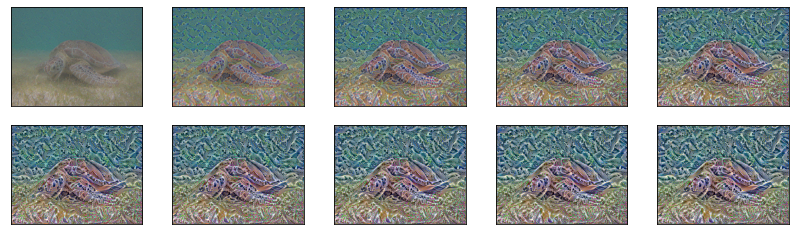

In [18]:
best_img, best_loss, display_interval, imgs, imgs_at_interval, epoch_loss = transfer_style(CONTENT_IMG, STYLE_IMG, epochs=200)

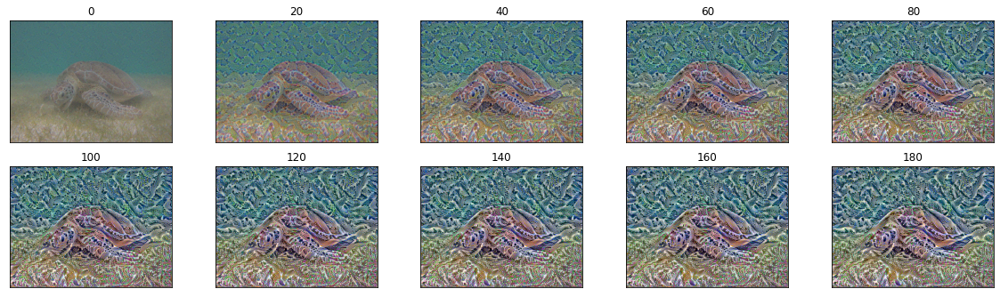

In [19]:
num_columns = 5
num_rows = (len(imgs) // num_columns) + (len(imgs) % num_columns)
row_height = 3
plt.figure(figsize=(20, row_height * num_rows))
for i, img in enumerate(imgs_at_interval):
    plt.subplot(num_rows, num_columns, i+1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    plt.title(int(display_interval * i))

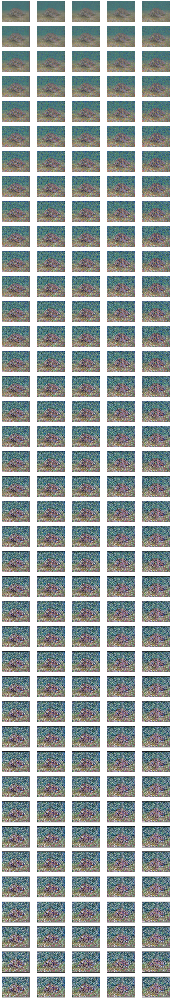

In [20]:
num_columns = 5
num_rows = (len(imgs) // num_columns) + (len(imgs) % num_columns)
row_height = 3
plt.figure(figsize=(20, row_height * num_rows))
for i, img in enumerate(imgs):
    plt.subplot(num_rows, num_columns, i+1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

### Visualize Outputs

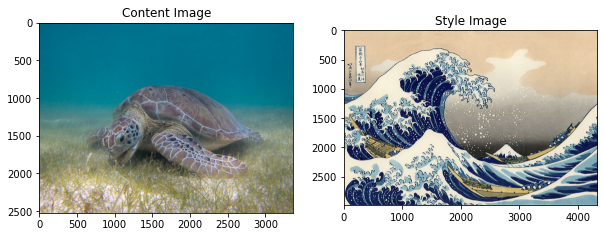

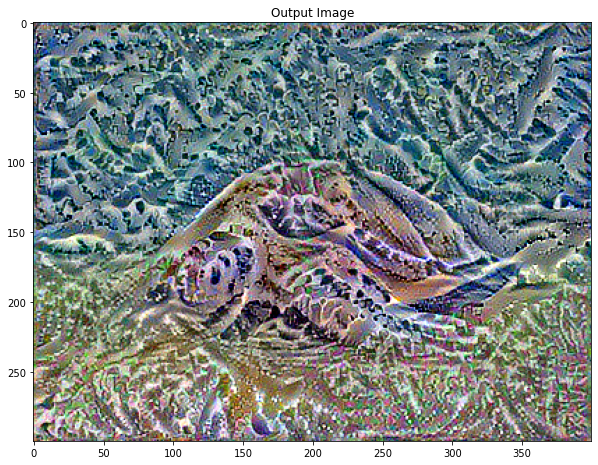

In [21]:
plt.figure(figsize=(10, 10))
content = Image.open(CONTENT_IMG) 
style = Image.open(STYLE_IMG)

plt.subplot(1, 2, 1)
plt.imshow(content)
plt.title('Content Image')

plt.subplot(1, 2, 2)
plt.imshow(style)
plt.title('Style Image')

plt.figure(figsize=(10, 10))

plt.imshow(best_img)
plt.title('Output Image')
plt.show()

This is a basic and beginner friendly implementation for `neural style transfer`.

---

## Tensorflow official guide for Neural Style Transfer

This notebook uses deep learning to compose one image in the style of another image. This is known as `neural style transfer` and the technique is outlined in <a href="https://arxiv.org/abs/1508.06576" class="external">A Neural Algorithm of Artistic Style</a> (Gatys et al.). 

Note: This section of the notebook demonstrates the `original style-transfer algorithm`. It optimizes the image content to a particular style. **Modern approaches train a model to generate the stylized image directly (similar to [cyclegan](cyclegan.ipynb)). This approach is much faster (up to 1000x)**.

For example, let’s take an image of this `dog` and `Wassily Kandinsky's Composition 7`:

<img src="https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg" width="500px"/>

[Yellow Labrador Looking](https://commons.wikimedia.org/wiki/File:YellowLabradorLooking_new.jpg), from Wikimedia Commons by [Elf](https://en.wikipedia.org/wiki/User:Elf). License [CC BY-SA 3.0](https://creativecommons.org/licenses/by-sa/3.0/deed.en)

<img src="https://storage.googleapis.com/download.tensorflow.org/example_images/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg" width="500px"/>


Now how would it look like if Kandinsky decided to paint the picture of this Dog exclusively with this style? Something like this?

<img src="https://tensorflow.org/tutorials/generative/images/stylized-image.png" style="width: 500px;"/>

In [22]:
import os
import time
import functools

import IPython.display as display

import PIL.Image

import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt

import tensorflow as tf

import tensorflow_hub as hub

### Setup

#### Import and configure modules

In [23]:
# Load compressed models from tensorflow_hub
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'

In [24]:
mpl.rcParams['figure.figsize'] = (12, 12)
mpl.rcParams['axes.grid'] = False

In [25]:
def tensor_to_image(tensor):
    # scaling the img values between 0-255 as the imgs values are 
    # currently between 0-1
    tensor = tensor * 255
    
    tensor = np.array(tensor, dtype=np.uint8)
    
    if np.ndim(tensor) > 3:
        assert tensor.shape[0] == 1   # checking for batch size to be 1 (individual img)
        tensor = tensor[0]            # getting the img from the batch of size 1
    return PIL.Image.fromarray(tensor)

Download images and choose a style image and a content image:

In [26]:
content_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
style_path = tf.keras.utils.get_file('kandinsky5.jpg','https://storage.googleapis.com/download.tensorflow.org/example_images/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg')

196608/195196 [==============================] - 0s 0us/step


### Visualize the input

Define a function to load an image and limit its maximum dimension to 512 pixels.

In [27]:
img = tf.io.read_file(content_path)
img = tf.image.decode_image(img, channels=3)
img = tf.image.convert_image_dtype(img, tf.float32)

print(tf.cast(tf.shape(img), tf.float32))
shape = tf.cast(tf.shape(img)[:-1], tf.float32)
print(shape)

max_dim = 480
long_dim = max(shape)
scale = max_dim / long_dim
new_shape = tf.cast(shape * scale, tf.int32)
img = tf.image.resize(img, new_shape)

print(f'Long dim: {long_dim}')
print(f'Scale: {scale}')
print(f'New shape: {new_shape}')

tf.Tensor([577. 700.   3.], shape=(3,), dtype=float32)
tf.Tensor([577. 700.], shape=(2,), dtype=float32)
Long dim: 700.0
Scale: 0.6857143044471741
New shape: [395 480]


In [28]:
def load_img(path_to_img):
    max_dim = 512
    
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)

    # removing the channel dim and getting other dims from the img shape
    shape = tf.cast(tf.shape(img)[:-1], tf.float32)  
    
    # getting the biggest dim in img shape
    long_dim = max(shape)
    
    # creating a factor to scale down the long_dim to less than equal to max_dim
    scale = max_dim / long_dim
    
    # scaling down all dims in the shape tensor, specailly making the long_dim
    # to size equal to max_dim
    new_shape = tf.cast(shape * scale, tf.int32)
    
    # resizing the img
    img = tf.image.resize(img, new_shape)  
    
    # adding a batch size (240, 240, 3) => (1, 240, 240, 3)
    img = img[tf.newaxis, :]
    return img

In [29]:
# To plot img
def imshow(image, title=None):
    if len(image.shape) > 3:
        # removing the batch shape
        image = tf.squeeze(image, axis=0)
    
    plt.imshow(image)
    if title:
        plt.title(title)

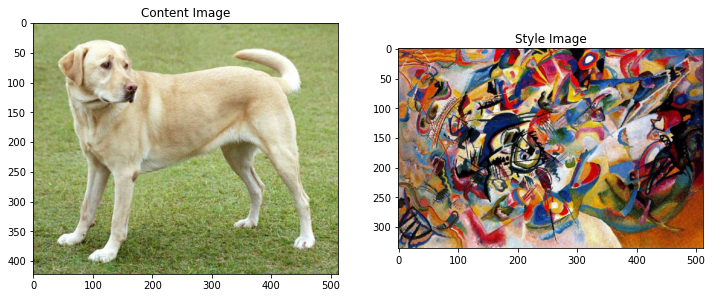

In [30]:
content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

### Fast Style Transfer using TF-Hub

This tutorial demonstrates the `original style-transfer algorithm`, which optimizes the image content to a particular style. Before getting into the details, let's see how the [TensorFlow Hub model](https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2) does this:

Total time: 1.75sec


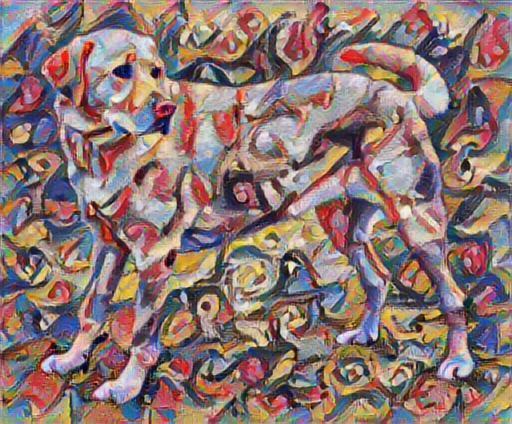

In [31]:
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')

start = time.time()
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0]
end   = time.time()

print(f'Total time: {round(end - start, 2)}sec')
tensor_to_image(stylized_image)

Using the `fast style transfer` approch gives beautiful and quick results. The remaining part of this notebook is about building a good `style transfer model` from scratch.

#### Define content and style representations

Use the `intermediate layers` of the model to get the `content` and `style` representations of the image. Starting from the network's input layer, the first few layer activations represent low-level features like edges and textures. As you step through the network, the final few layers represent higher-level features—object parts like **wheels** or **eyes**. In this case, you are using the `VGG19 network architecture`, a pretrained image classification network. These intermediate layers are necessary to define the representation of content and style from the images. For an input image, try to match the corresponding style and content target representations at these intermediate layers.

Load a VGG19 and test run it on our image to ensure it's used correctly:

In [32]:
print(content_image.numpy().min())
print(content_image.numpy().max())

0.0
1.0


In [33]:
x = tf.keras.applications.vgg19.preprocess_input(content_image * 255)
x = tf.image.resize(x, (224, 224))
vgg = tf.keras.applications.VGG19(include_top=True, weights='imagenet')
prediction_probabilities = vgg(x)
prediction_probabilities.shape

574717952/574710816 [==============================] - 4s 0us/step


TensorShape([1, 1000])

In [34]:
predicted_top_5 = tf.keras.applications.vgg19.decode_predictions(prediction_probabilities.numpy())[0]
[(class_name, prob) for (number, class_name, prob) in predicted_top_5]

40960/35363 [==================================] - 0s 0us/step


[('Labrador_retriever', 0.49317113),
 ('golden_retriever', 0.23665294),
 ('kuvasz', 0.03635755),
 ('Chesapeake_Bay_retriever', 0.024182769),
 ('Greater_Swiss_Mountain_dog', 0.018646104)]

Now load a VGG19 without the classification head, and list the layer names

In [35]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

print()
for layer in vgg.layers:
    print(layer.name)


input_4
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


Choose intermediate layers from the network to represent the style and content of the image:

In [36]:
content_layers = ['block5_conv2'] 

style_layers = [
    'block1_conv1',
    'block2_conv1',
    'block3_conv1', 
    'block4_conv1', 
    'block5_conv1'
]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

#### Intermediate layers for style and content

So why do these intermediate outputs within our pretrained image classification network allow us to define style and content representations?

At a high level, in order for a network to perform image classification (which this network has been trained to do), it must understand the image. This requires taking the raw image as input pixels and building an internal representation that converts the raw image pixels into a complex understanding of the features present within the image.

This is also a reason why convolutional neural networks are able to generalize well: they’re able to capture the invariances and defining features within classes (e.g. cats vs. dogs) that are agnostic to background noise and other nuisances. Thus, somewhere between where the raw image is fed into the model and the output classification label, the model serves as a complex feature extractor. By accessing intermediate layers of the model, you're able to describe the content and style of input images.

### Build the model 

The networks in `tf.keras.applications` are designed so you can easily extract the intermediate layer values using the Keras functional API.

To define a model using the functional API, specify the inputs and outputs:

`model = Model(inputs, outputs)`

This following function builds a VGG19 model that returns a list of intermediate layer outputs:

In [37]:
def vgg_layers(layer_names):
    ''' Creates a vgg model that returns a list of intermediate output values '''

    # Load our model. Load pretrained VGG, trained on imagenet data
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    
    # We are not training the model as it is already trained and we're just
    # passing imgs (content, style) through this model and getting the feature maps
    vgg.trainable = False
  
    outputs = [vgg.get_layer(name).output for name in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model

And to create the model:

In [38]:
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image * 255)

# Look at the statistics of each layer's output
for name, output in zip(style_layers, style_outputs):
    print(name)
    print('  shape: ', output.numpy().shape)
    print('  min: ', output.numpy().min())
    print('  max: ', output.numpy().max())
    print('  mean: ', output.numpy().mean())
    print()

block1_conv1
  shape:  (1, 336, 512, 64)
  min:  0.0
  max:  835.5256
  mean:  33.97525

block2_conv1
  shape:  (1, 168, 256, 128)
  min:  0.0
  max:  4625.8857
  mean:  199.82687

block3_conv1
  shape:  (1, 84, 128, 256)
  min:  0.0
  max:  8789.239
  mean:  230.78099

block4_conv1
  shape:  (1, 42, 64, 512)
  min:  0.0
  max:  21566.135
  mean:  791.24005

block5_conv1
  shape:  (1, 21, 32, 512)
  min:  0.0
  max:  3189.2542
  mean:  59.179478



#### Calculate style

The content of an image is represented by the values of the intermediate feature maps.

It turns out, the style of an image can be described by the means and correlations across the different feature maps. Calculate a Gram matrix that includes this information by taking the outer product of the feature vector with itself at each location, and averaging that outer product over all locations. This Gram matrix can be calculated for a particular layer as:

$$G^l_{cd} = \frac{\sum_{ij} F^l_{ijc}(x)F^l_{ijd}(x)}{IJ}$$

This can be implemented concisely using the `tf.linalg.einsum` function:

In [39]:
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)

#### Extract style and content

Build a model that returns the style and content tensors.

In [40]:
class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleContentModel, self).__init__()
        
        self.vgg = vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        
        self.vgg.trainable = False

    def call(self, inputs):
        'Expects float input in [0,1], which the current content and style imgs have'
        inputs = inputs * 255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        
        outputs = self.vgg(preprocessed_input)
        style_outputs, content_outputs = (outputs[:self.num_style_layers], outputs[self.num_style_layers:])

        # calculating gram matrix for each layer
        style_outputs = [gram_matrix(style_output) for style_output in style_outputs]

        content_dict = {content_name: value for content_name, value in zip(self.content_layers, content_outputs)}
        style_dict   = {style_name: value for style_name, value in zip(self.style_layers, style_outputs)}
        
        return {'content': content_dict, 'style': style_dict}

When called on an image, this model returns the gram matrix (style) of the `style_layers` and content of the `content_layers`:

In [41]:
extractor = StyleContentModel(style_layers, content_layers)
results = extractor(tf.constant(content_image))

print('Styles:')
for name, output in sorted(results['style'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())
    print()

print("Contents:")
for name, output in sorted(results['content'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())

Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.0055228444
    max:  28014.557
    mean:  263.79025

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  61479.473
    mean:  9100.949

   block3_conv1
    shape:  (1, 256, 256)
    min:  0.0
    max:  545623.44
    mean:  7660.976

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  4320501.5
    mean:  134288.84

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  110005.37
    mean:  1487.0378

Contents:
   block5_conv2
    shape:  (1, 26, 32, 512)
    min:  0.0
    max:  2410.8796
    mean:  13.764149


### Run gradient descent

With this `style and content extractor`, you can now implement the style transfer algorithm. Do this by calculating the `mean square error` for your image's output relative to each target, then take the `weighted sum` of these losses.

Set your style and content target values:

In [42]:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

Define a `tf.Variable` to contain the image to optimize. To make this quick, initialize it with the content image (the `tf.Variable` must be the same shape as the content image):

In [43]:
image = tf.Variable(content_image)

Since this is a float image, define a function to keep the pixel values between 0 and 1:

In [44]:
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

Create an optimizer. The paper recommends LBFGS, but `Adam` works okay, too:

In [45]:
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

To optimize this, use a weighted combination of the two losses to get the total loss:

In [46]:
# Hyper-parameters
style_weight = 1e-2
content_weight = 1e4

In [47]:
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']

    # Calculating the mean square error for each style layer and then summing it
    style_loss = tf.add_n([
        tf.reduce_mean((style_outputs[name]-style_targets[name])**2)  for name in style_outputs.keys()
    ])
    # Applying the hyper-parameter for style loss
    style_loss *= style_weight / num_style_layers

    # Calculating the mean square error for each content layer and then summing it
    content_loss = tf.add_n([
        tf.reduce_mean((content_outputs[name]-content_targets[name])**2) for name in content_outputs.keys()
    ])
    # Applying the hyper-parameter for content loss
    content_loss *= content_weight / num_content_layers
    
    # Combining both the loss
    loss = style_loss + content_loss
    return loss

Use `tf.GradientTape` to update the image.

In [48]:
@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs)

    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

Now run a few steps to test:

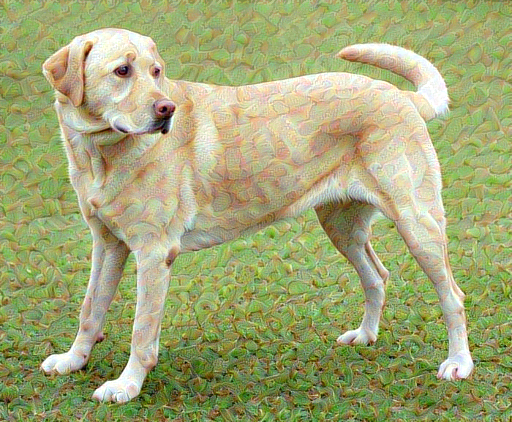

In [49]:
train_step(image)
train_step(image)
train_step(image)
tensor_to_image(image)

Since it's working, perform a longer optimization:

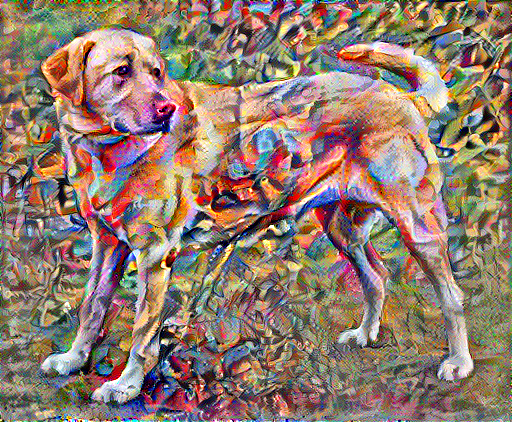

Train step: 1000
Total time: 38.2


In [50]:
start = time.time()

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
    for m in range(steps_per_epoch):
        step += 1
        train_step(image)
        print(".", end='')
    display.clear_output(wait=True)
    display.display(tensor_to_image(image))
    print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

### Total variation loss

One `downside` to this basic implementation is that it produces a `lot of high frequency artifacts`. Decrease these using an explicit `regularization` term on the high frequency components of the image. In style transfer, this is often called the `total variation loss`:

In [51]:
def high_pass_x_y(image):
    x_var = image[:, :, 1:, :] - image[:, :, :-1, :]
    y_var = image[:, 1:, :, :] - image[:, :-1, :, :]

    return x_var, y_var

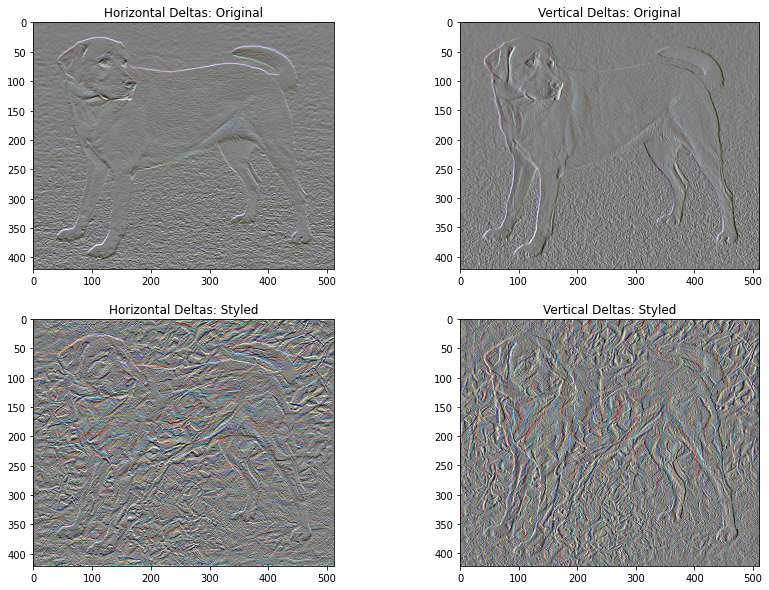

In [52]:
x_deltas, y_deltas = high_pass_x_y(content_image)

plt.figure(figsize=(14, 10))
plt.subplot(2, 2, 1)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Original")

plt.subplot(2, 2, 2)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Original")

x_deltas, y_deltas = high_pass_x_y(image)

plt.subplot(2, 2, 3)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Styled")

plt.subplot(2, 2, 4)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Styled")

This shows how the high frequency components have increased.

Also, this high frequency component is basically an `edge-detector`. You can get similar output from the `Sobel edge detector`, for example:

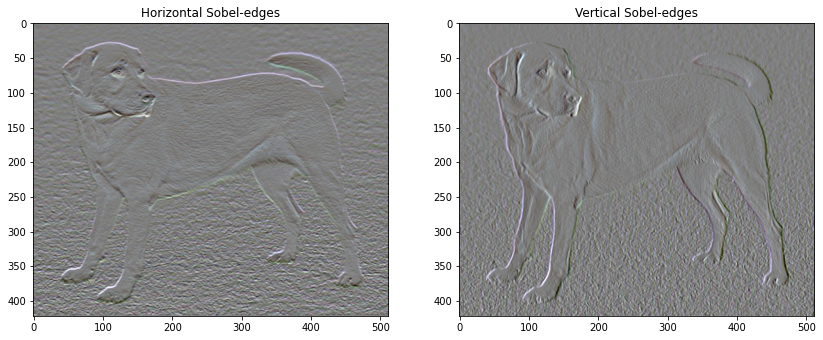

In [53]:
plt.figure(figsize=(14, 10))

sobel = tf.image.sobel_edges(content_image)
plt.subplot(1, 2, 1)
imshow(clip_0_1(sobel[..., 0]/4+0.5), "Horizontal Sobel-edges")
plt.subplot(1, 2, 2)
imshow(clip_0_1(sobel[..., 1]/4+0.5), "Vertical Sobel-edges")

The `regularization loss` associated with this is the sum of the squares of the values:

In [54]:
def total_variation_loss(image):
    x_deltas, y_deltas = high_pass_x_y(image)
    return tf.reduce_sum(tf.abs(x_deltas)) + tf.reduce_sum(tf.abs(y_deltas))

In [55]:
total_variation_loss(image).numpy()

149283.44

That demonstrated what it does. But there's no need to implement it yourself, TensorFlow includes a standard implementation:

In [56]:
tf.image.total_variation(image).numpy()

array([149283.44], dtype=float32)

### Re-run the optimization

Choose a weight for the `total_variation_loss`:

In [57]:
total_variation_weight = 30

Now include it in the `train_step` function:

In [58]:
@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs)
        loss += total_variation_weight * tf.image.total_variation(image)

    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

Reinitialize the optimization variable:

In [59]:
image = tf.Variable(content_image)

And run the optimization:

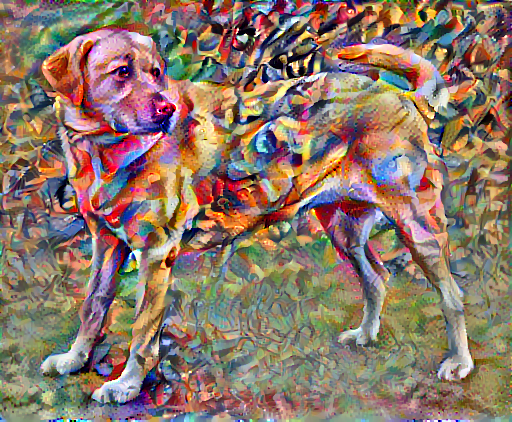

Train step: 1000
Total time: 39.9


In [60]:
start = time.time()

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
    for m in range(steps_per_epoch):
        step += 1
        train_step(image)
    print(".", end='')
    display.clear_output(wait=True)
    display.display(tensor_to_image(image))
    print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

Finally, save the result:

In [61]:
file_name = 'stylized-image.png'
tensor_to_image(image).save(file_name)

---

I'll wrap things up there. If you have any `questions` then do let me know.

If this kernel helped you then don't forget to 🔼 **upvote** and share your 🎙 **feedback** on improvements of the kernel.

![](https://media.giphy.com/media/7XygKlPkAeDllafscd/giphy.gif)